## Imports

In [21]:
# if necessary to install all the packages, run:
# !pip install -r requirements.txt

In [1]:
%load_ext lab_black

import pandas as pd
import numpy as np
from ydata_profiling import ProfileReport
import warnings
import time
import os
import json
import zipfile
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objects as go
from imblearn.pipeline import Pipeline, make_pipeline
from imblearn.over_sampling import SMOTE

from sklearn.preprocessing import MinMaxScaler, StandardScaler, LabelEncoder
from sklearn.model_selection import (
    train_test_split,
    GridSearchCV,
    cross_val_score,
    StratifiedKFold,
)
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import (
    confusion_matrix,
    accuracy_score,
    classification_report,
    roc_auc_score,
    f1_score,
    precision_score,
    recall_score,
)
from sklearn.manifold import TSNE
from imblearn.base import BaseSampler
from imblearn.over_sampling.base import BaseOverSampler
from sklearn.compose import ColumnTransformer, make_column_transformer


from sklearn.model_selection import KFold, GridSearchCV
from sklearn.preprocessing import StandardScaler, FunctionTransformer, OneHotEncoder
from sklearn.svm import SVC
from sklearn.metrics import classification_report
from sklearn.metrics import (
    confusion_matrix,
    accuracy_score,
    classification_report,
    roc_auc_score,
    f1_score,
    precision_score,
    recall_score,
)
from autorank import autorank, plot_stats, create_report, latex_table

import sdgym
from sdv.metadata import SingleTableMetadata
from sdv.single_table import (
    CTGANSynthesizer,
    TVAESynthesizer,
    GaussianCopulaSynthesizer,
    CopulaGANSynthesizer,
)
from sdv.lite import SingleTablePreset
from sdv.evaluation.single_table import (
    evaluate_quality,
    get_column_plot,
    get_column_pair_plot,
    run_diagnostic,
)
from sdv.sampling import Condition
from imblearn.utils import check_target_type
from scipy import sparse

warnings.filterwarnings("ignore")
sns.set(style="darkgrid", font_scale=0.5)
custom_palette = ["#8b4513", "#90ee90", "#545454", "#6a287e", "#f0be00"]
sns.set_palette(custom_palette)

## Funções

In [2]:
def dummy(df, columns):
    dummy_variables = []
    for column in columns:
        dummies = pd.get_dummies(df[column], prefix=column)
        dummy_variables.append(dummies)
    return dummy_variables

In [3]:
def label_encode_columns(df, columns_to_encode):
    label_encoder = LabelEncoder()

    for column in columns_to_encode:
        if column in df.columns:
            df[column] = label_encoder.fit_transform(df[column])

    return df

In [4]:
def convert_csv_to_zip_with_metadata(input_path, output_path):
    file_names = os.listdir(input_path)

    for file_name in file_names:
        if file_name.endswith(".csv"):
            csv_file = os.path.join(input_path, file_name)
            json_file = os.path.join(input_path, "metadata.json")
            if os.path.exists(json_file):
                zip_file_name = os.path.splitext(file_name)[0] + ".zip"
                zip_file_path = os.path.join(output_path, zip_file_name)

                with zipfile.ZipFile(zip_file_path, "w", zipfile.ZIP_DEFLATED) as zipf:
                    zipf.write(csv_file, arcname=os.path.basename(csv_file))
                    zipf.write(json_file, arcname="metadata.json")

In [5]:
def mean_std_results(mean_df, std_df):
    concatenated_results = []

    for index, row_mean in mean_df.iterrows():
        classificador = row_mean["Classification"]
        row_std = std_df.loc[std_df["Classification"] == classificador].squeeze()

        accuracy = f"{row_mean['Accuracy']:.4f} +- {row_std['Accuracy']:.2f}"
        precision = f"{row_mean['Precision']:.4f} +- {row_std['Precision']:.2f}"
        recall = f"{row_mean['Recall']:.4f} +- {row_std['Recall']:.2f}"
        f1 = f"{row_mean['F1 Score']:.4f} +- {row_std['F1 Score']:.2f}"
        roc_auc = f"{row_mean['ROC/AUC']:.4f} +- {row_std['ROC/AUC']:.2f}"

        concatenated_results.append(
            {
                "Classification": classificador,
                "Accuracy": accuracy,
                "Precision": precision,
                "Recall": recall,
                "F1 Score": f1,
                "ROC/AUC": roc_auc,
            }
        )

    return pd.DataFrame(concatenated_results)

In [32]:
def evaluation_pipeline(
    X,
    y,
    num_features: list,
    cat_features: list,
    sampling_strategy: str,
    metadata=None,
    target=None,
):
    print(f"Sampling Strategy: {sampling_strategy}")
    np.random.seed(42)

    num_outer_loop_folds = 5
    num_inner_loop_folds = 5
    results = []

    models = [
        (
            "SVM",
            SVC(),
            {"model__C": [0.1, 0.5, 1, 5, 10], "model__kernel": ["linear", "rbf"]},
        ),
        (
            "Decision Tree",
            DecisionTreeClassifier(),
            {
                "model__max_depth": [None, 1, 2, 5, 10],
                "model__min_samples_split": [2, 5, 10],
                "model__min_samples_leaf": [1, 5],
            },
        ),
        (
            "KNN",
            KNeighborsClassifier(),
            {
                "model__n_neighbors": [1, 3, 5, 7, 10],
                "model__weights": ["uniform", "distance"],
            },
        ),
        (
            "Random Forest",
            RandomForestClassifier(),
            {
                "model__n_estimators": [100, 200, 300],
                "model__max_depth": [None, 5, 10],
                "model__min_samples_split": [2, 5],
                "model__min_samples_leaf": [1, 5],
            },
        ),
        (
            "Logistic Regression",
            LogisticRegression(max_iter=1000),
            {
                "model__C": [0.1, 0.5, 1, 5, 10],
                "model__solver": ["liblinear", "sag", "saga"],
            },
        ),
        (
            "MLP",
            MLPClassifier(max_iter=1000),
            {
                "model__hidden_layer_sizes": [(100,), (100, 50)],
                "model__alpha": [0.0001, 0.001, 0.01],
            },
        ),
    ]

    columns_order = X.columns.tolist()

    num_transformer = ("numerical_standard_scaler", StandardScaler(), num_features)
    # cat_transformer = ("categorical_onehot", OneHotEncoder(), cat_features)
    transformers = [num_transformer]

    for name, model, param_grid in models:
        print(f"\nTraining Model: {model}")
        folds = KFold(n_splits=num_outer_loop_folds, shuffle=True).split(X, y)
        for i, (train_index, test_index) in enumerate(folds):
            print(f"Training fold {i + 1}...")

            X_train, y_train = X.iloc[train_index, :], y.iloc[train_index]
            X_test, y_test = X.iloc[test_index, :], y.iloc[test_index]

            normalization_step = (
                "normalization",
                ColumnTransformer(transformers=transformers, remainder="passthrough"),
            )
            model_step = ("model", model)

            if sampling_strategy == "TBTR":
                balance_classes_step = (
                    "resampling_tbtr",
                    SDVPipelineTBTR(
                        metadata=metadata,
                        target=target,
                        num_features=num_features,
                        cat_features=cat_features,
                        columns_order=columns_order,
                    ),
                )
                steps = [balance_classes_step, normalization_step, model_step]
            elif sampling_strategy == "TSTR":
                balance_classes_step = (
                    "resampling_tstr",
                    SDVPipelineTSTR(
                        metadata=metadata,
                        target=target,
                        num_features=num_features,
                        cat_features=cat_features,
                        columns_order=columns_order,
                    ),
                )
                steps = [balance_classes_step, normalization_step, model_step]
            elif sampling_strategy == "SMOTE":
                balance_classes_step = ("resampling_smote", SMOTE(random_state=42))
                steps = [balance_classes_step, normalization_step, model_step]
            elif sampling_strategy == "BASELINE":
                steps = [normalization_step, model_step]

            pipeline = Pipeline(steps=steps)

            clf = GridSearchCV(
                pipeline,
                param_grid,
                cv=num_inner_loop_folds,
                n_jobs=-1,
                scoring="accuracy",
            )  # scoring = accuracy ou roc_auc?
            clf.fit(X_train, y_train)

            y_pred = clf.predict(X_test)
            accuracy_test = accuracy_score(y_test, y_pred)
            f1_test = f1_score(y_test, y_pred)
            precision_test = precision_score(y_test, y_pred)
            recall_test = recall_score(y_test, y_pred)
            roc_auc_test = roc_auc_score(y_test, y_pred)

            results.append(
                {
                    "Classification": name,
                    "Accuracy": round(accuracy_test, 4),
                    "Precision": round(precision_test, 4),
                    "Recall": round(recall_test, 4),
                    "F1 Score": round(f1_test, 4),
                    "ROC/AUC": round(roc_auc_test, 4),
                }
            )

            with open("debug_test.txt", "w") as f:
                f.write(f"X_test: \n{X_test.shape}\n")
                f.write(f"y_test: {y_test.shape}\n")
                f.write(f"y_test distribution: \n{y_test.value_counts()}\n")

    mean_df = pd.DataFrame(results).groupby(["Classification"], as_index=False).mean()
    std_df = pd.DataFrame(results).groupby(["Classification"], as_index=False).std()
    results_df = mean_std_results(mean_df, std_df)
    return results_df

In [33]:
# TBTR (Treinar com Dados Balanceados [SDV + Dados Reais] , Testar com Dados Reais)
class SDVPipelineTBTR(BaseSampler):
    _sampling_type = "over-sampling"

    _parameter_constraints = {
        "X": [pd.DataFrame],
        "y": [pd.DataFrame, pd.Series],
        "metadata": [object],
        "target": [str],
        "num_features": [list],
        "cat_features": [list],
    }

    def __init__(self, metadata, target, num_features, cat_features, columns_order):
        self.metadata = metadata
        self.target = target
        self.num_features = num_features
        self.cat_features = cat_features
        self.columns_order = columns_order
        self.synthesizer = SingleTablePreset(self.metadata, name="FAST_ML")
        super().__init__()

    def _fit_resample(self, X, y):
        X = pd.DataFrame(X, columns=self.columns_order).reset_index(drop=True)
        y = pd.DataFrame(y, columns=[self.target]).reset_index(drop=True)
        df_train = pd.merge(X, y, left_index=True, right_index=True)

        for col in self.cat_features:
            df_train[col] = df_train[col].astype(int)

        self.synthesizer.fit(df_train)

        class_counts = y[self.target].value_counts()
        minority_class = class_counts.idxmin()
        synthetic_samples_needed = class_counts.max() - class_counts.min()

        if minority_class == 0:
            balanced_conditions_0 = Condition(
                num_rows=synthetic_samples_needed,
                column_values={self.target: 0},
            )
            df_synth = self.synthesizer.sample_from_conditions(
                conditions=[balanced_conditions_0]
            )
        elif minority_class == 1:
            balanced_conditions_1 = Condition(
                num_rows=synthetic_samples_needed,
                column_values={self.target: 1},
            )
            df_synth = self.synthesizer.sample_from_conditions(
                conditions=[balanced_conditions_1]
            )

        X_balanced = pd.concat(
            [
                X.reset_index(drop=True),
                df_synth.drop(self.target, axis=1).reset_index(drop=True),
            ],
            axis=0,
            ignore_index=True,
        )
        y_balanced = pd.concat(
            [y.reset_index(drop=True), df_synth[[self.target]].reset_index(drop=True)],
            axis=0,
            ignore_index=True,
        )

        X.to_csv("X.csv", index=False)
        y.to_csv("y.csv", index=False)
        df_train.to_csv("df_train.csv", index=False)
        X_balanced.to_csv("X_balanced.csv", index=False)
        y_balanced.to_csv("y_balanced.csv", index=False)
        with open("debug.txt", "w") as f:
            f.write(f"X: {X.shape}\n")
            f.write(f"y: {y.shape}\n")
            f.write(f"y: \n{y.value_counts()}\n")
            f.write(f"X_balanced: {X_balanced.shape}\n")
            f.write(f"y_balanced: {y_balanced.shape}\n")
            f.write(f"y_balanced: \n{y_balanced.value_counts()}\n")

        if sparse.issparse(X):
            X_balanced = sparse.vstack([X_balanced], format=X.format)
        else:
            X_balanced = np.vstack([X_balanced])

        y_balanced = pd.Series(np.ravel(y_balanced))

        self.X_balanced = X_balanced
        self.y_balanced = y_balanced

        X = X_balanced
        y = y_balanced

        return X_balanced, y_balanced

In [37]:
# TSTR (Treinar com Dados Sintéticos, Testar com Dados Reais)
# Dados Sintéticos Balanceados
class SDVPipelineTSTR(BaseSampler):
    _sampling_type = "over-sampling"

    _parameter_constraints = {
        "X": [pd.DataFrame],
        "y": [pd.DataFrame, pd.Series],
        "metadata": [object],
        "target": [str],
        "num_features": [list],
        "cat_features": [list],
    }

    def __init__(self, metadata, target, num_features, cat_features, columns_order):
        self.metadata = metadata
        self.target = target
        self.num_features = num_features
        self.cat_features = cat_features
        self.columns_order = columns_order
        self.synthesizer = SingleTablePreset(self.metadata, name="FAST_ML")
        super().__init__()

    def _fit_resample(self, X, y):
        X = pd.DataFrame(X, columns=self.columns_order).reset_index(drop=True)
        y = pd.DataFrame(y, columns=[self.target]).reset_index(drop=True)
        df_train = pd.merge(X, y, left_index=True, right_index=True)
        for col in self.cat_features:
            df_train[col] = df_train[col].astype(int)

        self.synthesizer.fit(df_train)

        class_counts = y[self.target].value_counts()
        majority_class = class_counts.idxmax()
        synthetic_samples_needed = class_counts.max()

        balanced_conditions_0 = Condition(
            num_rows=synthetic_samples_needed,
            column_values={self.target: 0},
        )

        balanced_conditions_1 = Condition(
            num_rows=synthetic_samples_needed,
            column_values={self.target: 1},
        )

        df_synth = self.synthesizer.sample_from_conditions(
            conditions=[balanced_conditions_0, balanced_conditions_1]
        )

        X_train_synth = df_synth.drop(self.target, axis=1)
        y_train_synth = df_synth[self.target]

        X.to_csv("X.csv", index=False)
        y.to_csv("y.csv", index=False)
        df_train.to_csv("df_train.csv", index=False)
        X_train_synth.to_csv("X_train_synth.csv", index=False)
        y_train_synth.to_csv("y_train_synth.csv", index=False)
        with open("debug.txt", "w") as f:
            f.write(f"X: {X.shape}\n")
            f.write(f"y: {y.shape}\n")
            f.write(f"y: \n{y.value_counts()}\n")
            f.write(f"X_train_synth: {X_train_synth.shape}\n")
            f.write(f"y_train_synth: {y_train_synth.shape}\n")
            f.write(f"y_train_synth: \n{y_train_synth.value_counts()}\n")

        if sparse.issparse(X):
            X_train_synth = sparse.vstack([X_train_synth], format=X.format)
        else:
            X_train_synth = np.vstack([X_train_synth])

        y_train_synth = pd.Series(np.ravel(y_train_synth))

        self.X_train_synth = X_train_synth
        self.y_train_synth = y_train_synth

        X = X_train_synth
        y = y_train_synth

        return X_train_synth, y_train_synth

In [9]:
def transform_gender(x):
    if x == "Female":
        return 1
    elif x == "Male":
        return 0
    else:
        return -1


def transform_customer_type(x):
    if x == "Loyal Customer":
        return 1
    elif x == "disloyal Customer":
        return 0
    else:
        return -1


def transform_travel_type(x):
    if x == "Business travel":
        return 1
    elif x == "Personal Travel":
        return 0
    else:
        return -1


def transform_class(x):
    if x == "Business":
        return 2
    elif x == "Eco Plus":
        return 1
    elif x == "Eco":
        return 0
    else:
        return -1


def transform_satisfaction(x):
    if x == "satisfied":
        return 1
    elif x == "neutral or dissatisfied":
        return 0
    else:
        return -1


def process_data(df):
    # df["Gender"] = df["Gender"].apply(transform_gender)
    df["Customer Type"] = df["Customer Type"].apply(transform_customer_type)
    df["Type of Travel"] = df["Type of Travel"].apply(transform_travel_type)
    df["Class"] = df["Class"].apply(transform_class)
    df["satisfaction"] = df["satisfaction"].apply(transform_satisfaction)
    df["Arrival Delay in Minutes"].fillna(
        df["Arrival Delay in Minutes"].median(), inplace=True
    )

    return df

## Análise do Dataset (EDA)

In [9]:
df = pd.read_csv("data/airline/airline_original.csv")

df_class_0 = df[df["satisfaction"] == "neutral or dissatisfied"]
df_class_1 = df[df["satisfaction"] == "satisfied"]

df_class_0_reduced = df_class_0.sample(frac=0.075, random_state=42)
df_class_1_reduced = df_class_1.sample(frac=0.075, random_state=42)
df = pd.concat([df_class_0_reduced, df_class_1_reduced]).reset_index(drop=True)
df.drop(
    columns=["id", "Gate location", "Gender", "Departure/Arrival time convenient"],
    axis=1,
    inplace=True,
)
df = process_data(df)

df

,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Ease of Online booking,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,35,1,2,530,4,4,1,4,1,1,3,5,5,5,4,1,0,0.0,0
1,1,68,0,0,1085,3,2,4,2,4,4,3,5,4,3,5,4,37,25.0,0
2,0,24,1,0,933,1,1,1,1,1,1,1,1,2,4,2,1,0,10.0,0
3,1,54,0,0,581,2,2,5,5,4,5,5,2,5,4,5,3,0,94.0,0
4,1,10,0,1,1096,3,2,1,2,1,1,3,1,3,3,3,1,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9736,1,70,1,2,2104,2,2,2,2,2,5,5,5,4,3,5,1,8,5.0,1
9737,1,50,1,0,532,4,4,4,4,4,4,2,2,5,3,3,4,0,0.0,1
9738,1,35,1,2,309,2,2,3,4,4,5,5,4,5,5,5,3,0,0.0,1
9739,1,36,1,2,844,1,1,2,1,3,4,4,4,4,4,4,2,0,0.0,1


In [ ]:
# df_class_0 = df[df["satisfaction"] == "neutral or dissatisfied"]
# df_class_1 = df[df["satisfaction"] == "satisfied"]

# df_class_0_reduced = df_class_0.sample(frac=0.025, random_state=42)
# df_class_1_reduced = df_class_1.sample(frac=0.025, random_state=42)
# df = pd.concat([df_class_0_reduced, df_class_1_reduced]).reset_index(drop=True)
# df.drop(
#     columns=["id", "Gate location", "Gender", "Departure/Arrival time convenient"],
#     axis=1,
#     inplace=True,
# )
# df = process_data(df)
# df.drop(columns=, axis=1, inplace=True)
# df.to_csv("data/airline/airline.csv", index=False)

In [8]:
df = pd.read_csv("data/airline/airline.csv")
df

,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Ease of Online booking,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,35,1,2,530,4,4,1,4,1,1,3,5,5,5,4,1,0,0.0,0
1,1,68,0,0,1085,3,2,4,2,4,4,3,5,4,3,5,4,37,25.0,0
2,0,24,1,0,933,1,1,1,1,1,1,1,1,2,4,2,1,0,10.0,0
3,1,54,0,0,581,2,2,5,5,4,5,5,2,5,4,5,3,0,94.0,0
4,1,10,0,1,1096,3,2,1,2,1,1,3,1,3,3,3,1,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3242,1,39,1,2,2565,2,2,5,4,4,4,4,4,4,5,4,3,0,0.0,1
3243,0,48,1,0,302,5,5,3,5,3,3,5,4,3,3,1,3,0,0.0,1
3244,1,55,1,2,544,5,5,5,4,4,3,3,3,3,5,3,3,0,0.0,1
3245,1,70,0,0,334,5,5,4,4,3,2,2,5,2,4,2,1,0,0.0,1


In [28]:
df.satisfaction.value_counts()

0    1836
1    1411
Name: satisfaction, dtype: int64

In [29]:
perc = df.satisfaction.value_counts()[1] / df.satisfaction.value_counts()[0]
perc

0.7685185185185185

In [18]:
profile = ProfileReport(
    df, title="Profiling Dataset", html={"style": {"full_width": True}}
)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Informações Gerais sobre o Dataset


df.shape[0] rows × 23 columns

dados foram balanceados

Feature Explanation:

Gender: Gender of the passengers (Female, Male)

Customer Type: The customer type (Loyal customer, disloyal customer)

Age: The actual age of the passengers

Type of Travel: Purpose of the flight of the passengers (Personal Travel, Business Travel)

Class: Travel class in the plane of the passengers (Business, Eco, Eco Plus)

Flight distance: The flight distance of this journey

Inflight wifi service: Satisfaction level of the inflight wifi service (0:Not Applicable;1-5)

Departure/Arrival time convenient: Satisfaction level of Departure/Arrival time convenient

Ease of Online booking: Satisfaction level of online booking

Gate location: Satisfaction level of Gate location

Food and drink: Satisfaction level of Food and drink

Online boarding: Satisfaction level of online boarding

Seat comfort: Satisfaction level of Seat comfort

Inflight entertainment: Satisfaction level of inflight entertainment

On-board service: Satisfaction level of On-board service

Leg room service: Satisfaction level of Leg room service

Baggage handling: Satisfaction level of baggage handling

Check-in service: Satisfaction level of Check-in service

Inflight service: Satisfaction level of inflight service

Cleanliness: Satisfaction level of Cleanliness

Departure Delay in Minutes: Minutes delayed when departure

Arrival Delay in Minutes: Minutes delayed when Arrival

Satisfaction: Airline satisfaction level(Satisfaction, neutral or dissatisfaction)

In [96]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3247 entries, 0 to 3246
Data columns (total 20 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Customer Type               3247 non-null   int64  
 1   Age                         3247 non-null   int64  
 2   Type of Travel              3247 non-null   int64  
 3   Class                       3247 non-null   int64  
 4   Flight Distance             3247 non-null   int64  
 5   Inflight wifi service       3247 non-null   int64  
 6   Ease of Online booking      3247 non-null   int64  
 7   Food and drink              3247 non-null   int64  
 8   Online boarding             3247 non-null   int64  
 9   Seat comfort                3247 non-null   int64  
 10  Inflight entertainment      3247 non-null   int64  
 11  On-board service            3247 non-null   int64  
 12  Leg room service            3247 non-null   int64  
 13  Baggage handling            3247 

In [97]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Customer Type,3247.0,0.813366,0.389677,0.0,1.0,1.0,1.0,1.0
Age,3247.0,39.658146,15.176011,7.0,27.0,40.0,51.0,85.0
Type of Travel,3247.0,0.686788,0.463871,0.0,0.0,1.0,1.0,1.0
Class,3247.0,1.010471,0.963225,0.0,0.0,1.0,2.0,2.0
Flight Distance,3247.0,1191.455189,1006.193312,67.0,416.0,829.0,1744.0,4983.0
Inflight wifi service,3247.0,2.774869,1.338380,0.0,2.0,3.0,4.0,5.0
Ease of Online booking,3247.0,2.778257,1.403098,0.0,2.0,3.0,4.0,5.0
Food and drink,3247.0,3.193409,1.332625,0.0,2.0,3.0,4.0,5.0
Online boarding,3247.0,3.250693,1.347499,0.0,2.0,3.0,4.0,5.0
Seat comfort,3247.0,3.472744,1.303266,1.0,3.0,4.0,5.0,5.0


## Criando os Dados Sintetizados

In [86]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6494 entries, 0 to 6493
Data columns (total 20 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Customer Type               6494 non-null   int64  
 1   Age                         6494 non-null   int64  
 2   Type of Travel              6494 non-null   int64  
 3   Class                       6494 non-null   int64  
 4   Flight Distance             6494 non-null   int64  
 5   Inflight wifi service       6494 non-null   int64  
 6   Ease of Online booking      6494 non-null   int64  
 7   Food and drink              6494 non-null   int64  
 8   Online boarding             6494 non-null   int64  
 9   Seat comfort                6494 non-null   int64  
 10  Inflight entertainment      6494 non-null   int64  
 11  On-board service            6494 non-null   int64  
 12  Leg room service            6494 non-null   int64  
 13  Baggage handling            6494 

### Metadata

In [69]:
metadata = SingleTableMetadata()
metadata.detect_from_dataframe(data=df)
metadata

{
    "METADATA_SPEC_VERSION": "SINGLE_TABLE_V1",
    "columns": {
        "Customer Type": {
            "sdtype": "numerical"
        },
        "Age": {
            "sdtype": "numerical"
        },
        "Type of Travel": {
            "sdtype": "numerical"
        },
        "Class": {
            "sdtype": "numerical"
        },
        "Flight Distance": {
            "sdtype": "numerical"
        },
        "Inflight wifi service": {
            "sdtype": "numerical"
        },
        "Ease of Online booking": {
            "sdtype": "numerical"
        },
        "Food and drink": {
            "sdtype": "numerical"
        },
        "Online boarding": {
            "sdtype": "numerical"
        },
        "Seat comfort": {
            "sdtype": "numerical"
        },
        "Inflight entertainment": {
            "sdtype": "numerical"
        },
        "On-board service": {
            "sdtype": "numerical"
        },
        "Leg room service": {
            "sdtype": "

In [70]:
metadata.update_column(
    column_name="Arrival Delay in Minutes",
    sdtype="numerical",
    computer_representation="Float",
)

In [32]:
metadata.save_to_json(filepath="data/airline/metadata.json")

In [33]:
convert_csv_to_zip_with_metadata("data/airline/", "data/my_custom_datasets/")

### Constraints

In [159]:
# age_constraint = {
#     "constraint_class": "ScalarRange",
#     "constraint_parameters": {
#         "column_name": "age",
#         "low_value": 29.0,
#         "high_value": 77.0,
#         "strict_boundaries": False,
#     },
# }

### Synthesizers

#### CTGAN

In [34]:
synthesizer = CTGANSynthesizer(metadata)
# synthesizer.add_constraints(constraints=[age_constraint])

In [35]:
start_time = time.time()

synthesizer.fit(df)

end_time = time.time()

ctgan_time = round(end_time - start_time, 3)

In [36]:
ctgan_time

1363.693

In [37]:
synthesizer.save("models/airline/CTGAN_synthesizer.pkl")

In [11]:
synthesizer = CTGANSynthesizer.load("models/airline/CTGAN_synthesizer.pkl")

In [12]:
df_synth = synthesizer.sample(df.shape[0])

In [13]:
quality_report = evaluate_quality(df, df_synth, metadata)

Creating report: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  5.58it/s]


Overall Quality Score: 91.45%

Properties:
Column Shapes: 92.79%
Column Pair Trends: 90.1%


In [14]:
diagnostic_report = run_diagnostic(
    real_data=df, synthetic_data=df_synth, metadata=metadata
)

diagnostic_report

Creating report: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [01:11<00:00, 17.98s/it]


DiagnosticResults:

SUCCESS:
✓ The synthetic data covers over 90% of the numerical ranges present in the real data
✓ Over 90% of the synthetic rows are not copies of the real data
✓ The synthetic data follows over 90% of the min/max boundaries set by the real data


In [15]:
ctgan_score = quality_report.get_score()
ctgan_score = round(ctgan_score, 3)
ctgan_score

0.914

In [16]:
results_shape = quality_report.get_details(property_name="Column Shapes")
results_pair = quality_report.get_details(property_name="Column Pair Trends")

results_shape = results_shape.groupby(by="Metric").mean().reset_index()
results_shape["Model"] = "CTGAN"
results_shape = results_shape[["Model", "Metric", "Quality Score"]]

results_pair = results_pair.groupby(by="Metric").mean().reset_index()
results_pair["Model"] = "CTGAN"
results_pair = results_pair[["Model", "Metric", "Quality Score"]]

result_ctgan = pd.concat([results_shape, results_pair], ignore_index=True)
result_ctgan

,Model,Metric,Quality Score
0,CTGAN,KSComplement,0.927918
1,CTGAN,CorrelationSimilarity,0.900997


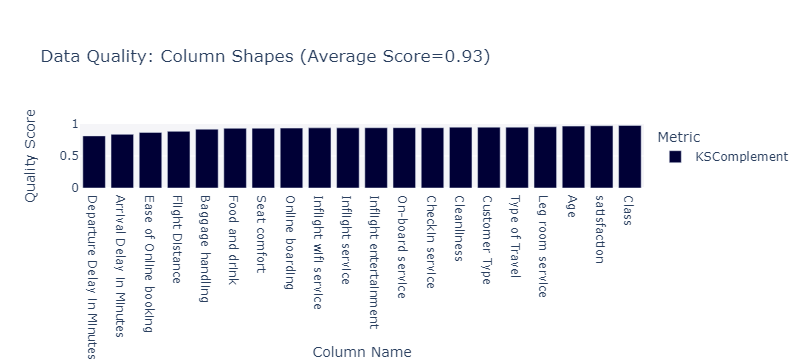

In [17]:
quality_report.get_visualization("Column Shapes")

#### CopulaGAN

In [44]:
synthesizer = CopulaGANSynthesizer(metadata)
# synthesizer.add_constraints(constraints=[age_constraint])

In [45]:
start_time = time.time()

synthesizer.fit(df)

end_time = time.time()

copula_time = round(end_time - start_time, 3)

In [46]:
copula_time

1315.327

In [47]:
synthesizer.save("models/airline/CopulaGAN_synthesizer.pkl")

In [18]:
synthesizer = CopulaGANSynthesizer.load("models/airline/CopulaGAN_synthesizer.pkl")

In [19]:
df_synth = synthesizer.sample(df.shape[0])

In [20]:
quality_report = evaluate_quality(df, df_synth, metadata)

Creating report: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  5.42it/s]


Overall Quality Score: 90.13%

Properties:
Column Shapes: 88.25%
Column Pair Trends: 92.02%


In [21]:
diagnostic_report = run_diagnostic(
    real_data=df, synthetic_data=df_synth, metadata=metadata
)

diagnostic_report

Creating report: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [01:11<00:00, 17.95s/it]


DiagnosticResults:

SUCCESS:
✓ The synthetic data covers over 90% of the numerical ranges present in the real data
✓ Over 90% of the synthetic rows are not copies of the real data
✓ The synthetic data follows over 90% of the min/max boundaries set by the real data


In [22]:
copula_score = quality_report.get_score()
copula_score = round(copula_score, 3)
copula_score

0.901

In [23]:
results_shape = quality_report.get_details(property_name="Column Shapes")
results_pair = quality_report.get_details(property_name="Column Pair Trends")

results_shape = results_shape.groupby(by="Metric").mean().reset_index()
results_shape["Model"] = "CopulaGAN"
results_shape = results_shape[["Model", "Metric", "Quality Score"]]

results_pair = results_pair.groupby(by="Metric").mean().reset_index()
results_pair["Model"] = "CopulaGAN"
results_pair = results_pair[["Model", "Metric", "Quality Score"]]

result_copula = pd.concat([results_shape, results_pair], ignore_index=True)
result_copula

,Model,Metric,Quality Score
0,CopulaGAN,KSComplement,0.882476
1,CopulaGAN,CorrelationSimilarity,0.920190


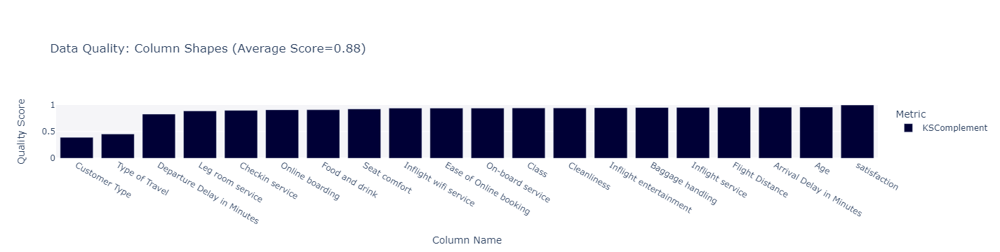

In [24]:
quality_report.get_visualization("Column Shapes")

#### GaussianCopula

In [54]:
synthesizer = GaussianCopulaSynthesizer(metadata)
# synthesizer.add_constraints(constraints=[age_constraint])

In [55]:
start_time = time.time()

synthesizer.fit(df)

end_time = time.time()

gaussian_time = round(end_time - start_time, 3)

In [56]:
gaussian_time

2.267

In [57]:
synthesizer.save("models/airline/GaussianCopula_synthesizer.pkl")

In [25]:
synthesizer = GaussianCopulaSynthesizer.load(
    "models/airline/GaussianCopula_synthesizer.pkl"
)

In [26]:
df_synth = synthesizer.sample(df.shape[0])

In [27]:
quality_report = evaluate_quality(df, df_synth, metadata)

Creating report: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  5.84it/s]


Overall Quality Score: 89.66%

Properties:
Column Shapes: 82.0%
Column Pair Trends: 97.32%


In [28]:
diagnostic_report = run_diagnostic(
    real_data=df, synthetic_data=df_synth, metadata=metadata
)

diagnostic_report

Creating report: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [01:12<00:00, 18.06s/it]


DiagnosticResults:

SUCCESS:
✓ The synthetic data covers over 90% of the numerical ranges present in the real data
✓ Over 90% of the synthetic rows are not copies of the real data
✓ The synthetic data follows over 90% of the min/max boundaries set by the real data


In [29]:
gaussian_score = quality_report.get_score()
gaussian_score = round(gaussian_score, 3)
gaussian_score

0.897

In [30]:
results_shape = quality_report.get_details(property_name="Column Shapes")
results_pair = quality_report.get_details(property_name="Column Pair Trends")

results_shape = results_shape.groupby(by="Metric").mean().reset_index()
results_shape["Model"] = "GaussianCopula"
results_shape = results_shape[["Model", "Metric", "Quality Score"]]

results_pair = results_pair.groupby(by="Metric").mean().reset_index()
results_pair["Model"] = "GaussianCopula"
results_pair = results_pair[["Model", "Metric", "Quality Score"]]

result_gaussian = pd.concat([results_shape, results_pair], ignore_index=True)
result_gaussian

,Model,Metric,Quality Score
0,GaussianCopula,KSComplement,0.819972
1,GaussianCopula,CorrelationSimilarity,0.973231


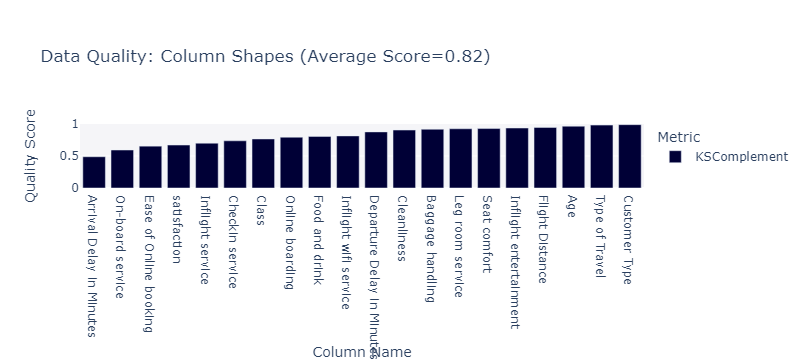

In [31]:
quality_report.get_visualization("Column Shapes")

#### TVAE

In [64]:
synthesizer = TVAESynthesizer(metadata)
# synthesizer.add_constraints(constraints=[age_constraint])

In [65]:
start_time = time.time()

synthesizer.fit(df)

end_time = time.time()

tvae_time = round(end_time - start_time, 3)

In [66]:
tvae_time

249.795

In [67]:
synthesizer.save("models/airline/TVAE_synthesizer.pkl")

In [32]:
synthesizer = TVAESynthesizer.load("models/airline/TVAE_synthesizer.pkl")

In [33]:
df_synth = synthesizer.sample(df.shape[0])

In [34]:
quality_report = evaluate_quality(df, df_synth, metadata)

Creating report: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  5.67it/s]


Overall Quality Score: 88.61%

Properties:
Column Shapes: 85.47%
Column Pair Trends: 91.74%


In [35]:
diagnostic_report = run_diagnostic(
    real_data=df, synthetic_data=df_synth, metadata=metadata
)

diagnostic_report

Creating report: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [01:12<00:00, 18.19s/it]


DiagnosticResults:

SUCCESS:
✓ Over 90% of the synthetic rows are not copies of the real data
✓ The synthetic data follows over 90% of the min/max boundaries set by the real data

! The synthetic data is missing more than 10% of the numerical ranges present in the real data


In [36]:
tvae_score = quality_report.get_score()
tvae_score = round(tvae_score, 3)
tvae_score

0.886

In [37]:
results_shape = quality_report.get_details(property_name="Column Shapes")
results_pair = quality_report.get_details(property_name="Column Pair Trends")

results_shape = results_shape.groupby(by="Metric").mean().reset_index()
results_shape["Model"] = "TVAE"
results_shape = results_shape[["Model", "Metric", "Quality Score"]]

results_pair = results_pair.groupby(by="Metric").mean().reset_index()
results_pair["Model"] = "TVAE"
results_pair = results_pair[["Model", "Metric", "Quality Score"]]

result_tvae = pd.concat([results_shape, results_pair], ignore_index=True)
result_tvae

,Model,Metric,Quality Score
0,TVAE,KSComplement,0.854712
1,TVAE,CorrelationSimilarity,0.917408


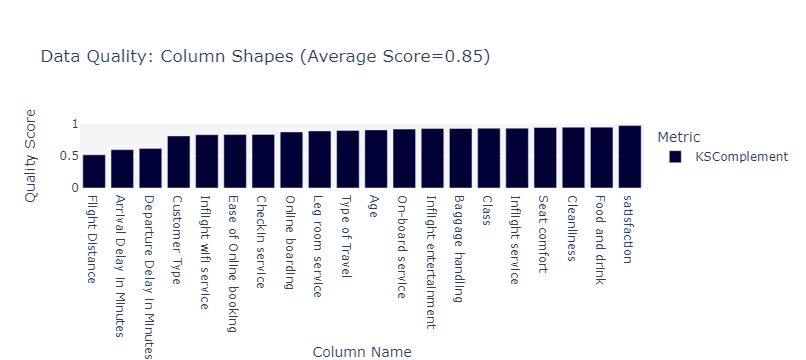

In [38]:
quality_report.get_visualization("Column Shapes")

#### FastML

In [71]:
synthesizer = SingleTablePreset(metadata, name="FAST_ML")
# synthesizer.add_constraints(constraints=[age_constraint])

In [72]:
start_time = time.time()

synthesizer.fit(df)

end_time = time.time()

fast_time = round(end_time - start_time, 3)

In [73]:
fast_time

4.558

In [74]:
synthesizer.save("models/airline/FastML_synthesizer.pkl")

In [75]:
synthesizer = SingleTablePreset.load("models/airline/FastML_synthesizer.pkl")

In [40]:
df_synth = synthesizer.sample(df.shape[0])

In [41]:
quality_report = evaluate_quality(df, df_synth, metadata)

Creating report: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  5.60it/s]


Overall Quality Score: 95.03%

Properties:
Column Shapes: 91.44%
Column Pair Trends: 98.63%


In [42]:
diagnostic_report = run_diagnostic(
    real_data=df, synthetic_data=df_synth, metadata=metadata
)

diagnostic_report

Creating report: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [01:14<00:00, 18.51s/it]


DiagnosticResults:

SUCCESS:
✓ The synthetic data covers over 90% of the numerical ranges present in the real data
✓ Over 90% of the synthetic rows are not copies of the real data
✓ The synthetic data follows over 90% of the min/max boundaries set by the real data


In [76]:
fast_score = quality_report.get_score()
fast_score = round(fast_score, 3)
fast_score

0.95

In [44]:
results_shape = quality_report.get_details(property_name="Column Shapes")
results_pair = quality_report.get_details(property_name="Column Pair Trends")

results_shape = results_shape.groupby(by="Metric").mean().reset_index()
results_shape["Model"] = "FastML"
results_shape = results_shape[["Model", "Metric", "Quality Score"]]

results_pair = results_pair.groupby(by="Metric").mean().reset_index()
results_pair["Model"] = "FastML"
results_pair = results_pair[["Model", "Metric", "Quality Score"]]

result_fast = pd.concat([results_shape, results_pair], ignore_index=True)
result_fast

,Model,Metric,Quality Score
0,FastML,KSComplement,0.914383
1,FastML,CorrelationSimilarity,0.986303


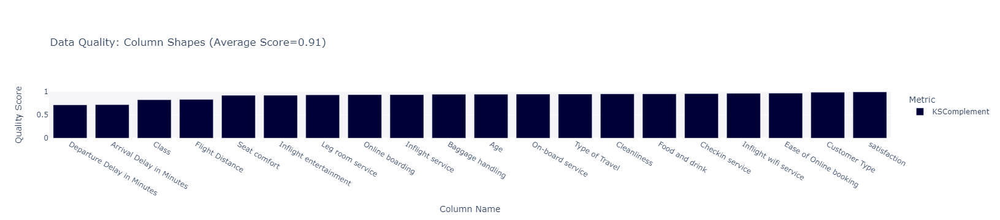

In [45]:
quality_report.get_visualization("Column Shapes")

### Análise da Geração dos Dados Sintéticos

In [48]:
data_score = {
    "Model": ["FastML", "TVAE", "GaussianCopula", "CopulaGAN", "CTGAN"],
    "Mean Score": [
        fast_score,
        tvae_score,
        gaussian_score,
        copula_score,
        ctgan_score,
    ],
    # "Time": [fast_time, tvae_time, gaussian_time, copula_time, ctgan_time],
}

df_score = pd.DataFrame(data_score)
df_score = df_score.sort_values(by="Mean Score", ascending=False).reset_index(drop=True)
df_score.to_csv("data/airline/results/mean_score.csv", index=False)
df_score

,Model,Mean Score
0,FastML,0.950
1,CTGAN,0.914
2,CopulaGAN,0.901
3,GaussianCopula,0.897
4,TVAE,0.886


In [49]:
metrics_score = pd.concat(
    [result_copula, result_ctgan, result_fast, result_gaussian, result_tvae],
    ignore_index=True,
)
metrics_score.to_csv("data/airline/results/metrics_score.csv", index=False)
metrics_score

,Model,Metric,Quality Score
0,CopulaGAN,KSComplement,0.882476
1,CopulaGAN,CorrelationSimilarity,0.920190
2,CTGAN,KSComplement,0.927918
3,CTGAN,CorrelationSimilarity,0.900997
4,FastML,KSComplement,0.914383
5,FastML,CorrelationSimilarity,0.986303
6,GaussianCopula,KSComplement,0.819972
7,GaussianCopula,CorrelationSimilarity,0.973231
8,TVAE,KSComplement,0.854712
9,TVAE,CorrelationSimilarity,0.917408


### Comparação Dados Reais vs. Dados Sintéticos

In [87]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3247 entries, 0 to 3246
Data columns (total 20 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Customer Type               3247 non-null   int64  
 1   Age                         3247 non-null   int64  
 2   Type of Travel              3247 non-null   int64  
 3   Class                       3247 non-null   int64  
 4   Flight Distance             3247 non-null   int64  
 5   Inflight wifi service       3247 non-null   int64  
 6   Ease of Online booking      3247 non-null   int64  
 7   Food and drink              3247 non-null   int64  
 8   Online boarding             3247 non-null   int64  
 9   Seat comfort                3247 non-null   int64  
 10  Inflight entertainment      3247 non-null   int64  
 11  On-board service            3247 non-null   int64  
 12  Leg room service            3247 non-null   int64  
 13  Baggage handling            3247 

### TSNE

In [10]:
df = pd.read_csv("data/airline/airline.csv")
synthesizer = SingleTablePreset.load("models/airline/FastML_synthesizer.pkl")
df_synth = synthesizer.sample(df.shape[0])

X = pd.concat([df, df_synth], axis=0)
y = pd.Series([0] * len(df) + [1] * len(df_synth))

tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X)

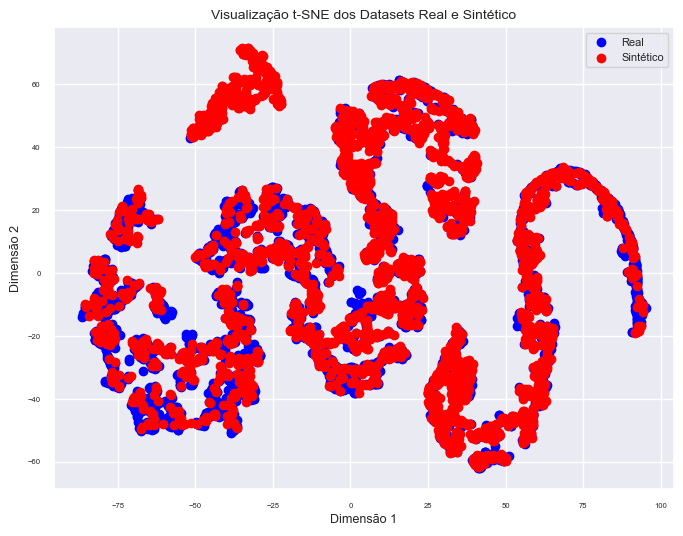

In [13]:
plt.figure(figsize=(8, 6))
plt.scatter(X_tsne[y == 0][:, 0], X_tsne[y == 0][:, 1], label="Real", c="blue")
plt.scatter(X_tsne[y == 1][:, 0], X_tsne[y == 1][:, 1], label="Sintético", c="red")
plt.legend(fontsize=8)
plt.title("Visualização t-SNE dos Datasets Real e Sintético", fontsize=10)
plt.xlabel("Dimensão 1", fontsize=9)
plt.ylabel("Dimensão 2", fontsize=9)
plt.savefig("data/airline/results/airline_tsne.png")
plt.show()

## Processos de Classificação

### Apenas com os Dados Reais

In [24]:
df = pd.read_csv("data/airline/airline_original.csv")

df_class_0 = df[df["satisfaction"] == "neutral or dissatisfied"]
df_class_1 = df[df["satisfaction"] == "satisfied"]

df_class_0_reduced = df_class_0.sample(frac=0.2, random_state=42)
df_class_1_reduced = df_class_1.sample(frac=0.2, random_state=42)
df = pd.concat([df_class_0_reduced, df_class_1_reduced]).reset_index(drop=True)
df.drop(
    columns=["id", "Gate location", "Gender", "Departure/Arrival time convenient"],
    axis=1,
    inplace=True,
)
df = process_data(df)

In [27]:
cat_features = [
    "Customer Type",
    "Type of Travel",
    "Class",
    "Inflight wifi service",
    "Ease of Online booking",
    "Food and drink",
    "Online boarding",
    "Seat comfort",
    "Inflight entertainment",
    "On-board service",
    "Leg room service",
    "Baggage handling",
    "Checkin service",
    "Inflight service",
    "Cleanliness",
]

num_features = [
    "Age",
    "Flight Distance",
    "Departure Delay in Minutes",
    "Arrival Delay in Minutes",
]

target = "satisfaction"

metadata = SingleTableMetadata()
metadata.detect_from_dataframe(data=df)
metadata

metadata.update_column(
    column_name="Arrival Delay in Minutes",
    sdtype="numerical",
    computer_representation="Float",
)

y = df[target]
X = df.drop(target, axis=1)

In [28]:
X

,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Ease of Online booking,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
10351,1,42,0,0,802,3,3,2,3,2,2,2,3,4,4,3,2,1,7.0
18675,0,41,1,0,129,5,5,1,5,1,1,5,4,4,5,2,1,0,0.0
16015,0,24,1,0,528,4,4,5,4,5,5,3,2,4,3,4,5,2,0.0
4093,1,33,1,2,1987,4,4,3,4,3,4,4,4,4,2,4,1,1,0.0
3757,1,18,0,0,280,2,2,5,2,5,5,3,2,4,3,5,5,15,20.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2715,1,65,0,0,405,3,3,2,3,2,2,5,4,5,5,5,2,0,0.0
8288,1,13,0,0,1452,2,2,2,2,4,2,3,5,4,2,3,2,130,118.0
22162,1,44,1,2,1849,3,3,3,4,5,3,3,3,3,3,3,5,21,33.0
4293,1,47,1,1,323,2,1,5,4,3,3,3,2,3,3,3,1,0,0.0


### Baseline: Avaliação dos Modelos apenas com Dados Reais

In [29]:
baseline_df = evaluation_pipeline(
    X=X,
    y=y,
    num_features=num_features,
    cat_features=cat_features,
    sampling_strategy="BASELINE",
)
baseline_df.to_csv("data/airline/results/baseline_df.csv", index=False)
baseline_df

Sampling Strategy: BASELINE

Training Model: SVC()
Training fold 1...


KeyboardInterrupt: 

### TBTR: Avaliação por Incrementação Dados Sintéticos + Reais, apenas no conjunto de treino

In [34]:
tbtr_df = evaluation_pipeline(
    X=X,
    y=y,
    num_features=num_features,
    cat_features=cat_features,
    sampling_strategy="TBTR",
    metadata=metadata,
    target=target,
)
tbtr_df.to_csv("data/airline/results/tbtr_df.csv", index=False)
tbtr_df

Sampling Strategy: TBTR

Training Model: SVC()
Training fold 1...


Sampling conditions: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 122/122 [00:00<00:00, 1340.68it/s]


Training fold 2...


Sampling conditions: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:00<00:00, 1134.01it/s]


Training fold 3...


Sampling conditions: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████| 116/116 [00:00<00:00, 834.54it/s]


Training fold 4...


Sampling conditions: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 126/126 [00:00<00:00, 1298.99it/s]


Training fold 5...


Sampling conditions: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:00<00:00, 1208.33it/s]



Training Model: DecisionTreeClassifier()
Training fold 1...


Sampling conditions: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 124/124 [00:00<00:00, 1305.28it/s]


Training fold 2...


Sampling conditions: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:00<00:00, 1031.00it/s]


Training fold 3...


KeyboardInterrupt: 

### TSTR: Treinar com dados sintéticos, testar com dados reais

In [38]:
tstr_df = evaluation_pipeline(X = X, y = y, num_features = num_features, cat_features = cat_features, sampling_strategy = "TSTR", metadata = metadata, target = target)
tstr_df.to_csv("data/airline/results/tstr_df.csv", index=False)
tstr_df

Sampling Strategy: TSTR

Training Model: SVC()
Training fold 1...


Sampling conditions: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 922/922 [00:00<00:00, 3942.64it/s]


Training fold 2...


Sampling conditions: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 910/910 [00:00<00:00, 4232.96it/s]


Training fold 3...


Sampling conditions: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 916/916 [00:00<00:00, 4280.85it/s]


Training fold 4...


Sampling conditions: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 926/926 [00:00<00:00, 3858.34it/s]


Training fold 5...


Sampling conditions: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 910/910 [00:00<00:00, 4155.26it/s]



Training Model: DecisionTreeClassifier()
Training fold 1...


KeyboardInterrupt: 

### SMOTE: Treinar com dados balanceados utilizando SMOTE, testar com dados reais

In [ ]:
smote_df = evaluation_pipeline(X = X, y = y, num_features = num_features, cat_features = cat_features, sampling_strategy = "SMOTE")
smote_df.to_csv("data/airline/results/smote_df.csv", index=False)
smote_df

### Final

In [ ]:
baseline_df

In [ ]:
tbtr_df

In [ ]:
tstr_df

In [ ]:
smote_df